# Movie Review Visualization

In [ ]:
from utils import *
import pandas as pd
import numpy as np
from wordcloud import WordCloud
import seaborn as sns
from matplotlib import pyplot as plt
%matplotlib inline

## Data Import

### Only RT data

In [33]:
# out_path = "./pickles/"
# NUM_OF_PROCESSES = 8
# preprocessed_df = merge_pickle_dfs('preprocessed_', NUM_OF_PROCESSES, out_path)

In [34]:
# df = preprocessed_df.drop(preprocessed_df.columns[0], axis=1)
# df.head()

,movie,reviewer,review,score,cleaned_review
29944,the grudge,Allen Almachar,I wish I could tell you that this latest itera...,49.0,wish could tell latest iteration good version ...


### Final Dataset

In [ ]:
%run main.py

In [ ]:
df = final_rt_df
df.head()

In [ ]:
df["discrepancy"] = df["score"] - df["audience_rating"]
df["diverse"] = df["tomatometer_rating"] - df["audience_rating"]
df["abs_diverse"] = abs(df["diverse"])
df["sentiment"] = ["Positive" if x>0 else "Negative" for x in df['vader_sentiment']]
df.head()

In [ ]:
print(df.score.describe())
print("--------------------------------")
print(df.tomatometer_rating.describe())
print("--------------------------------")
print(df.audience_rating.describe())
## similar scale of scores

### merged with top reviewers

In [ ]:
## top reviewers
top_critics = pd.read_csv("./raw_datasets/rt_top_critics.csv", header=None)
top_critics = top_critics[0].tolist()

In [ ]:
## check overlapping of our list and the dataset
def intersection(lst1, lst2):
    lst3 = [value for value in lst1 if value in lst2]
    return lst3

print("top critics: ",len( top_critics ))
print("all reviewers: ", len(df.reviewer.unique()))
print("intersections: ",len( intersection(top_critics, df.reviewer.unique()) ))

In [ ]:
df['top_critics'] = [name in top_critics for name in df['reviewer']]
df.head()

## General Visualization

D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


count    2.793500e+05
mean     7.545712e+07
std      1.039522e+08
min      6.079400e+04
25%      1.260023e+07
50%      3.818093e+07
75%      9.361701e+07
max      8.583730e+08
Name: domestic gross, dtype: float64

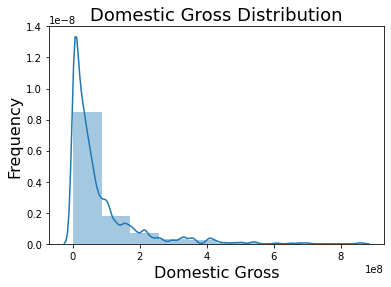

In [12]:
sns.distplot(df['domestic gross'], bins=10)
plt.title('Domestic Gross Distribution', fontsize=18)
plt.xlabel('Domestic Gross', fontsize=16)
plt.ylabel('Frequency', fontsize=16)
df['domestic gross'].describe()

In [ ]:
sns.distplot(df["tomatometer_rating"], bins=10, color='b')
sns.distplot(df["audience_rating"], bins=10, color='g')
plt.title('Rating Distribution', fontsize=18)
plt.xlabel('Movie Score', fontsize=16)
plt.ylabel('Frequency', fontsize=16)
plt.legend(['Reviewer Rating','Audience Rating'])

D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


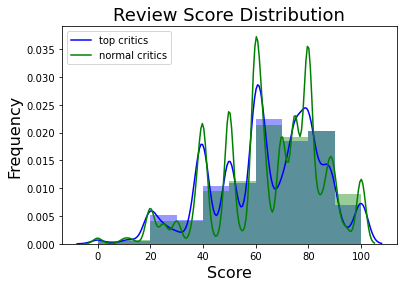

In [88]:
sns.distplot(df[df.top_critics==True]['score'], bins=10, color='b')
sns.distplot(df[df.top_critics==False]['score'], bins=10, color='g')
plt.title('Review Score Distribution', fontsize=18)
plt.xlabel('Score', fontsize=16)
plt.ylabel('Frequency', fontsize=16)
plt.legend(['top critics','normal critics'])
## no difference between top critics and others

In [79]:
stats = df.groupby("movie").agg({"score":["count","mean"]})
stats.columns = list(map('_'.join, stats.columns.values))
stats = stats.sort_values("score_count", axis = 0, ascending = False)
stats.head(10)

,score_count,score_mean
movie,,
halloween,2448,69.784926
the lion king,1764,62.170068
beauty and the beast,1548,68.591085
a star is born,1360,81.327171
inside out,1040,89.332692
robin hood,992,40.645161
ghost in the shell,832,56.954327
the girl with the dragon tattoo,816,77.362745
frozen,780,78.146154


D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0, 0.5, 'Frequency')

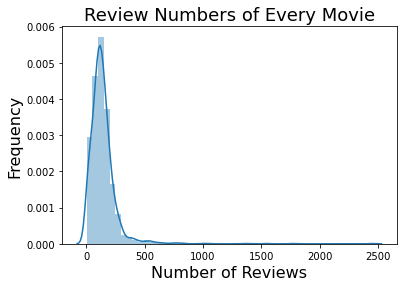

In [90]:
sns.distplot(stats['score_count'])
# sns.histplot(df['score'],bins=10)
plt.title('Review Numbers of Every Movie', fontsize=18)
plt.xlabel('Number of Reviews', fontsize=16)
plt.ylabel('Frequency', fontsize=16)

D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0, 0.5, 'Frequency')

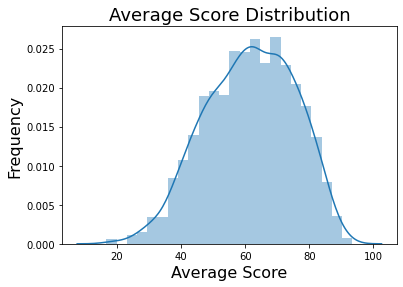

In [91]:
# sns.distplot(stats['score_mean'])
# # sns.histplot(df['score'],bins=10)
# plt.title('Average Score Distribution', fontsize=18)
# plt.xlabel('Average Score', fontsize=16)
# plt.ylabel('Frequency', fontsize=16)

In [92]:
## group by top critics
stats_top = df.groupby(['movie', 'top_critics'])['score'].count().unstack().fillna(0)
stats_top.columns = ["normal reviewers","top critics"]
stats_top["total"] = stats_top.sum(axis=1)
stats_top.sort_values("total", axis = 0, ascending = False, inplace=True)
stats_top.iloc[:,:2].head()

,normal reviewers,top critics
movie,,
halloween,2277.0,171.0
the lion king,1596.0,168.0
beauty and the beast,1434.0,114.0
a star is born,1236.0,124.0
inside out,928.0,112.0


Text(0.5, 0, 'Number of Reviews')

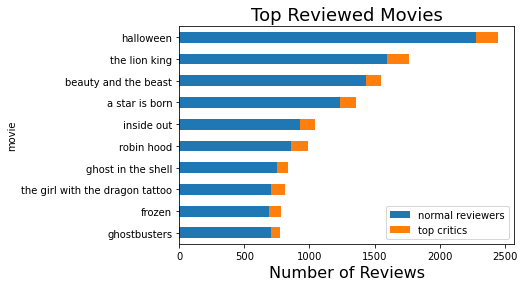

In [93]:
col_map1 = plt.get_cmap('Blues')(np.linspace(0.7, 0.3, 10))

stats_top.iloc[:10,:2].plot(kind='barh', stacked=True).invert_yaxis()
# stats.score_count[:10].plot(kind='barh',color=col_map1).invert_yaxis()
plt.title('Top Reviewed Movies', fontsize=18)
plt.xlabel('Number of Reviews', fontsize=16)

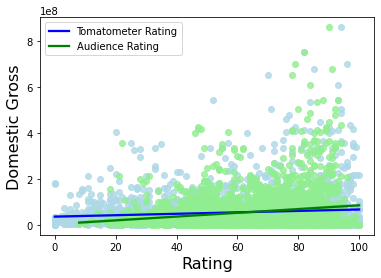

In [31]:
# sns.scatterplot(x=df.tomatometer_rating, y=df["domestic gross"], alpha = 0.5)
# sns.scatterplot(x=df.audience_rating, y=df["domestic gross"], alpha = 0.5)
score = df[["movie","tomatometer_rating","audience_rating","domestic gross"]].drop_duplicates()
sns.regplot(x=score.tomatometer_rating, y=score["domestic gross"],scatter_kws={"color": "lightblue"}, line_kws={"color": "blue"})
sns.regplot(x=score.audience_rating, y=score["domestic gross"],scatter_kws={"color": "lightgreen"}, line_kws={"color": "green"})
# plt.title('Review Score Distribution', fontsize=18)
plt.xlabel('Rating', fontsize=16)
plt.ylabel('Domestic Gross', fontsize=16)
plt.legend(['Tomatometer Rating','Audience Rating'])

Text(0.5, 1.0, 'Top 10 highest rated movies')

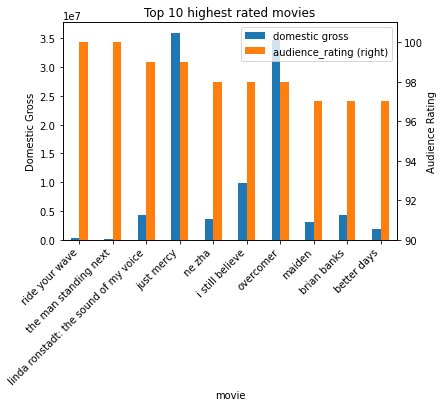

In [59]:
col_map1 = plt.get_cmap('Blues')(np.linspace(0.7, 0.3, 10))

score.sort_values("audience_rating", axis = 0, ascending = False, inplace=True)
tmp = score.iloc[:10,][["movie","domestic gross","audience_rating"]]
tmp.set_index("movie", inplace = True)
# .plot(kind='barh', stacked=True).invert_yaxis()
# stats.score_count[:10].plot(kind='barh',color=col_map1).invert_yaxis()
# plt.title('Top Reviewed Movies', fontsize=18)
# plt.xlabel('Number of Reviews', fontsize=16)
tmp.plot( kind= 'bar' , secondary_y= 'audience_rating' , rot= 0 )
ax1, ax2 = plt.gcf().get_axes()
ax2.set_ylim(90,101);
ax1.set_ylabel("Domestic Gross")
ax2.set_ylabel("Audience Rating")
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45, horizontalalignment='right')
ax1.set_title("Top 10 highest rated movies")

Text(0.5, 1.0, 'Top 10 best-sales movies')

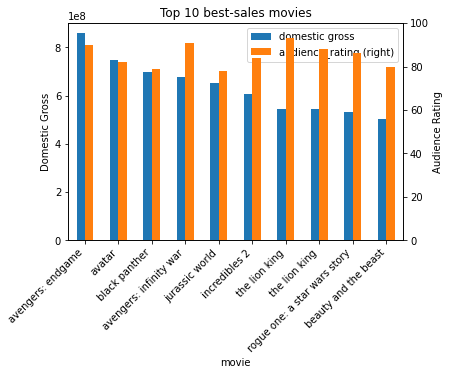

In [68]:
col_map1 = plt.get_cmap('Blues')(np.linspace(0.7, 0.3, 10))

score.sort_values("domestic gross", axis = 0, ascending = False, inplace=True)
tmp = score.iloc[:10,][["movie","domestic gross","audience_rating"]]
tmp.set_index("movie", inplace = True)
# .plot(kind='barh', stacked=True).invert_yaxis()
# stats.score_count[:10].plot(kind='barh',color=col_map1).invert_yaxis()
# plt.title('Top Reviewed Movies', fontsize=18)
# plt.xlabel('Number of Reviews', fontsize=16)
tmp.plot( kind= 'bar' , secondary_y= 'audience_rating' , rot= 0 )
ax1, ax2 = plt.gcf().get_axes()
ax2.set_ylim(0,100)
ax1.set_ylabel("Domestic Gross")
ax2.set_ylabel("Audience Rating")
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45, horizontalalignment='right')
ax1.set_title("Top 10 best-sales movies")

### Discrepancy

In [76]:
disc = df.groupby(["movie","diverse"]).agg({"score":["count","mean","std"]})
disc.columns = list(map('_'.join, disc.columns.values))
disc.reset_index(inplace = True)
disc = disc.sort_values("score_std", axis = 0, ascending = False)
disc.head(10)
## top 1 discrepancy movie: new york

,movie,diverse,score_count,score_mean,score_std
1140,new york,-9.0,3,69.166667,43.035838
45,a question of faith,-37.0,2,74.500000,36.062446
1133,neighbors,10.0,3,51.666667,28.431204
1132,neighbors,8.0,3,51.666667,28.431204
2109,unplanned,-50.0,16,54.062500,27.409168
9,2016: obama's america,-47.0,23,41.713043,26.677166
370,compadres,-13.0,6,44.166667,26.536139
780,i hope they serve beer in hell,-22.0,31,34.000000,26.211639
2050,to save a life,-43.0,18,52.916667,26.038010
1204,overcomer,-45.0,12,58.958333,25.815304


In [77]:
## movie with top diversity between critics and audience
disc["abs_diverse"] = abs(disc.diverse)
disc.sort_values("abs_diverse", axis = 0, ascending = False).head(10)

,movie,diverse,score_count,score_mean,score_std,abs_diverse
736,home,-86.0,108,57.050926,14.898557,86.0
1494,sparkle,-80.0,78,58.910256,14.927257,80.0
733,hillary's america: the secret history of the d...,-76.0,22,19.431818,22.036385,76.0
113,america: imagine the world without her,-76.0,18,32.111111,24.822046,76.0
1951,the silencing,-72.0,18,51.916667,10.962838,72.0
1047,meet the mormons,-71.0,6,53.833333,15.370968,71.0
938,last ounce of courage,-69.0,13,27.384615,22.208439,69.0
75,adam,66.0,10,73.200000,14.560601,66.0
1181,old fashioned,-66.0,17,45.617647,22.992886,66.0
1650,the condemned,-64.0,6,38.583333,15.875820,64.0


In [1]:
ny = df[df.movie=="new york"]
ny = ny.sort_values("discrepancy", axis = 0, ascending = False).reset_index(drop=True)
print("Best score review: ", ny.review[0])
print("Worst score review: ", ny.review.iloc[-1])
# ny.head()

NameError: name 'df' is not defined

## Text Mining

### 1. word count

In [71]:
## word count
## function from lecture
df["word_count"] = df.review.apply(count_fun)
df["word_count_unique"] = df.review.apply(count_fun_unique)
df.head()

,unnamed: 0,movie,reviewer,review,score,cleaned_review,vader_sentiment,release year,rerelease,domestic gross,...,tomatometer_count,audience_rating,audience_count,top_critics,discrepacy,diverse,abs_diverse,discrepancy,word_count,word_count_unique
0,389,together,Lynn Venhaus,Perhaps reliving a public health emergency tha...,69.0,perhaps reliving public health emergency fresh...,0.3818,2021,N,214390,...,81.0,89.0,7756.0,False,-21.0,1.0,1.0,-20.0,25,22
1,389,together,Lynn Venhaus,Perhaps reliving a public health emergency tha...,69.0,perhaps reliving public health emergency fresh...,0.3818,2001,N,1034829,...,81.0,89.0,7756.0,False,-21.0,1.0,1.0,-20.0,25,22
2,390,together,Tracey Petherick,The portrait of a seemingly doomed relationshi...,80.0,portrait seemingly doomed relationship shadow ...,-0.6369,2021,N,214390,...,81.0,89.0,7756.0,False,-10.0,1.0,1.0,-9.0,22,21
3,390,together,Tracey Petherick,The portrait of a seemingly doomed relationshi...,80.0,portrait seemingly doomed relationship shadow ...,-0.6369,2001,N,1034829,...,81.0,89.0,7756.0,False,-10.0,1.0,1.0,-9.0,22,21
4,391,together,Jesse Hassenger,When Together confronts the helpless living ni...,69.0,confronts helpless living nightmare pandemic o...,-0.7964,2021,N,214390,...,81.0,89.0,7756.0,False,-21.0,1.0,1.0,-20.0,18,17


D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


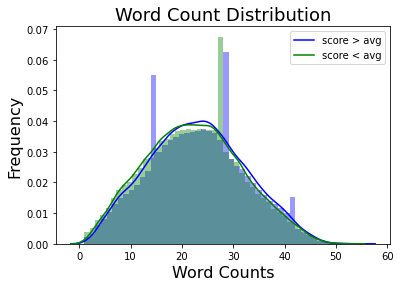

In [72]:
## word count frequency
avg = df['score'].mean()

sns.distplot(df[df['score']>=avg]["word_count"], color='b')
sns.distplot(df[df['score']<avg]["word_count"], color='g')
plt.title('Word Count Distribution', fontsize=18)
plt.xlabel('Word Counts', fontsize=16)
plt.ylabel('Frequency', fontsize=16)
plt.legend(['score > avg','score < avg'])

D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


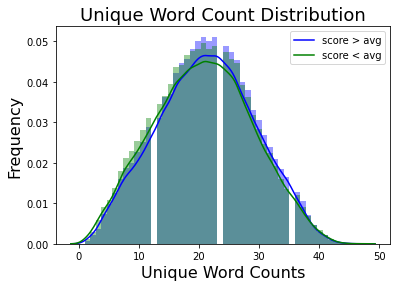

In [73]:
## unique word count frequency
avg = df['score'].mean()

sns.distplot(df[df['score']>=avg]["word_count_unique"], color='b')
sns.distplot(df[df['score']<avg]["word_count_unique"], color='g')
plt.title('Unique Word Count Distribution', fontsize=18)
plt.xlabel('Unique Word Counts', fontsize=16)
plt.ylabel('Frequency', fontsize=16)
plt.legend(['score > avg','score < avg'])

### 2. Word Frequency

In [70]:
## the wordcloud image is saved to the directory "wordcloud"
## notebook preview provided
def wordcloud(method, df_in, col_lab, col_text, movies):
    from wordcloud import WordCloud
    from matplotlib import pyplot as plt
    from sklearn.feature_extraction.text import TfidfVectorizer
    
#     sns.set()
    plt.rcParams['figure.figsize'] = [50, 40]
    
    x, y = np.ogrid[:900, :900]
    mask = (x - 450) ** 2 + (y - 450) ** 2 > 390 ** 2
    mask = 255 * mask.astype(int)

    wordcloud = WordCloud(background_color="white", mask=mask, # contour_width=0, contour_color="black",
                          max_font_size=150, random_state=42,
                          colormap="Dark2")

    for i, movie in enumerate(movies):
        tmp = df_in[df_in[col_lab] == movie]
        
        if method == "freq":
            tmp_concat = tmp[col_text].str.cat(sep=" ")
            wordcloud.generate(text=tmp_concat)
        elif method == "tf-idf":
            ## completing
            cv = TfidfVectorizer()
            tfidf = cv.fit_transform(tmp[col_text])
            sum_tf = pd.DataFrame(tfidf.sum(axis=0))
            sum_tf.columns = cv.get_feature_names()
            
            wordcloud.generate_from_frequencies(sum_tf.T[0])
        else:
            return "method not applicable"
        
        wordcloud.to_file(f'./wordcloud/{method}_{movie}.png')
#         plt.subplot(4, 1, i+1)
        plt.imshow(wordcloud, interpolation="bilinear")
        plt.axis("off")
        plt.title(movie)
        plt.show()

#### 2.1. word frequency per movie

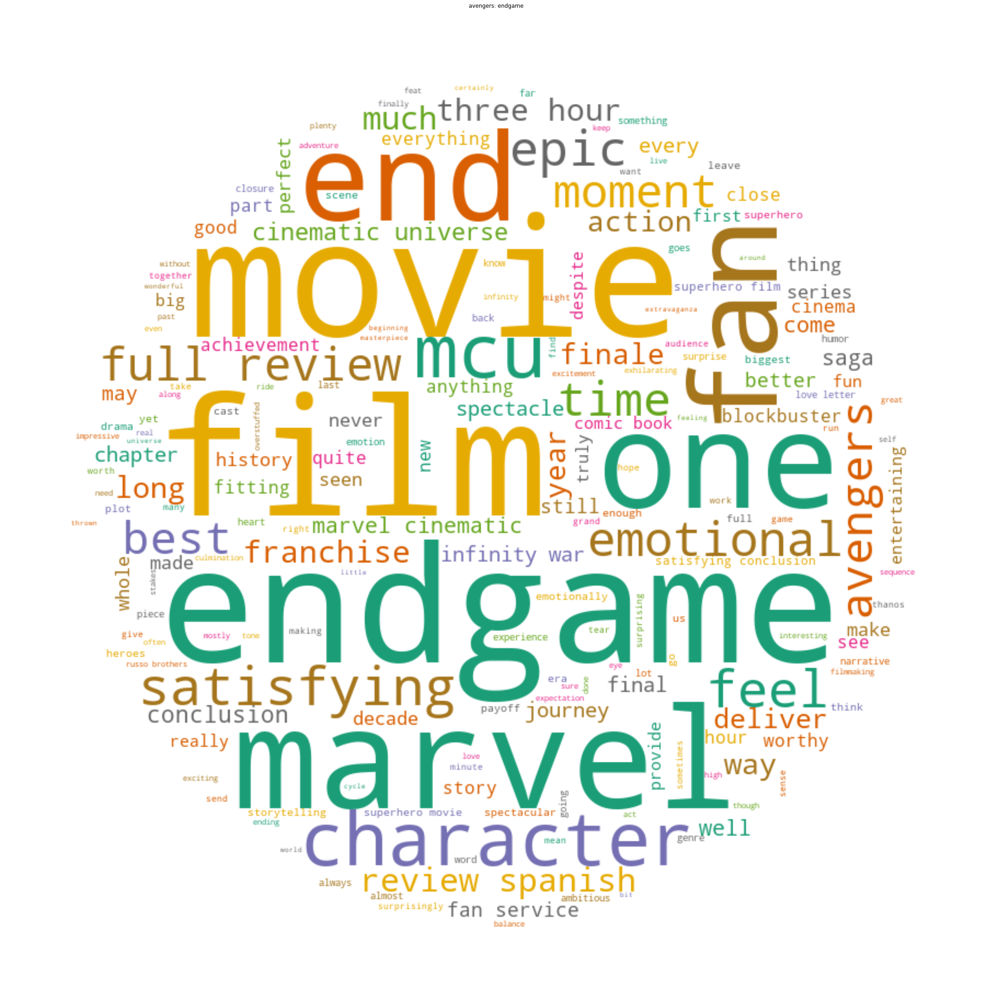

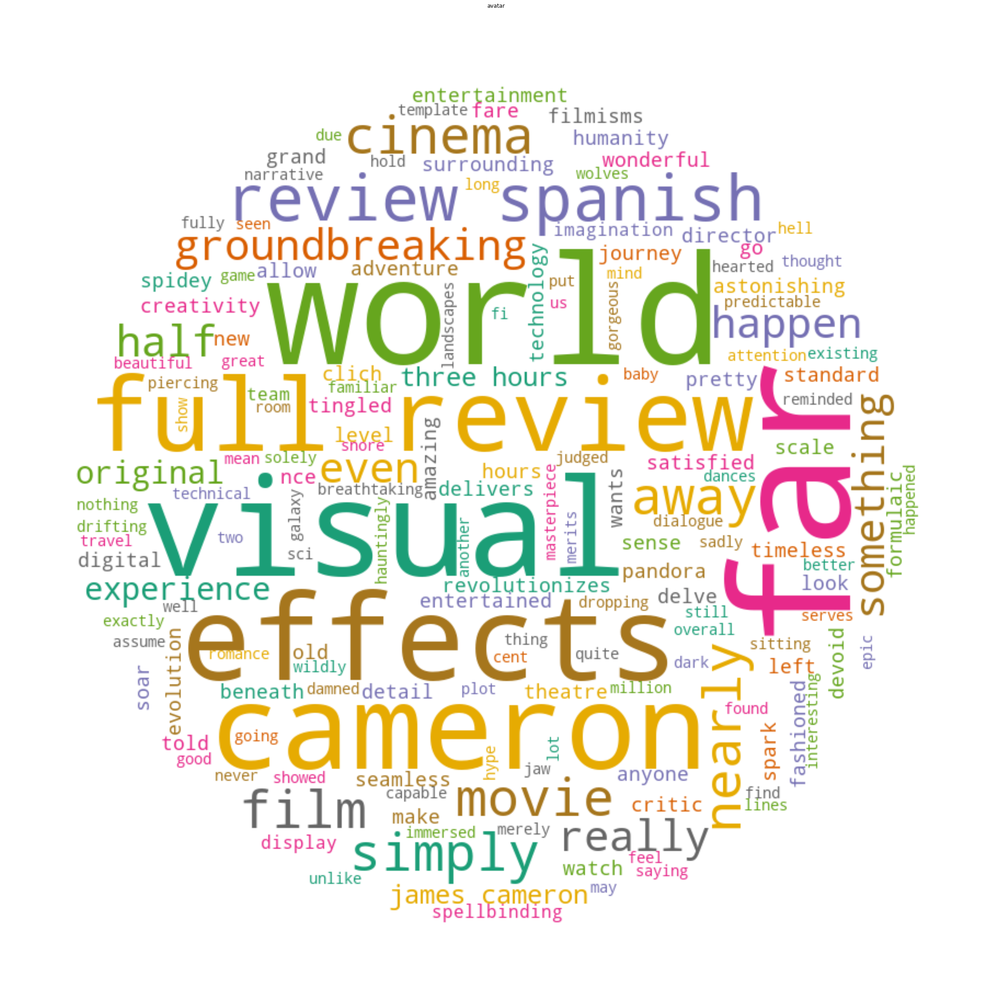

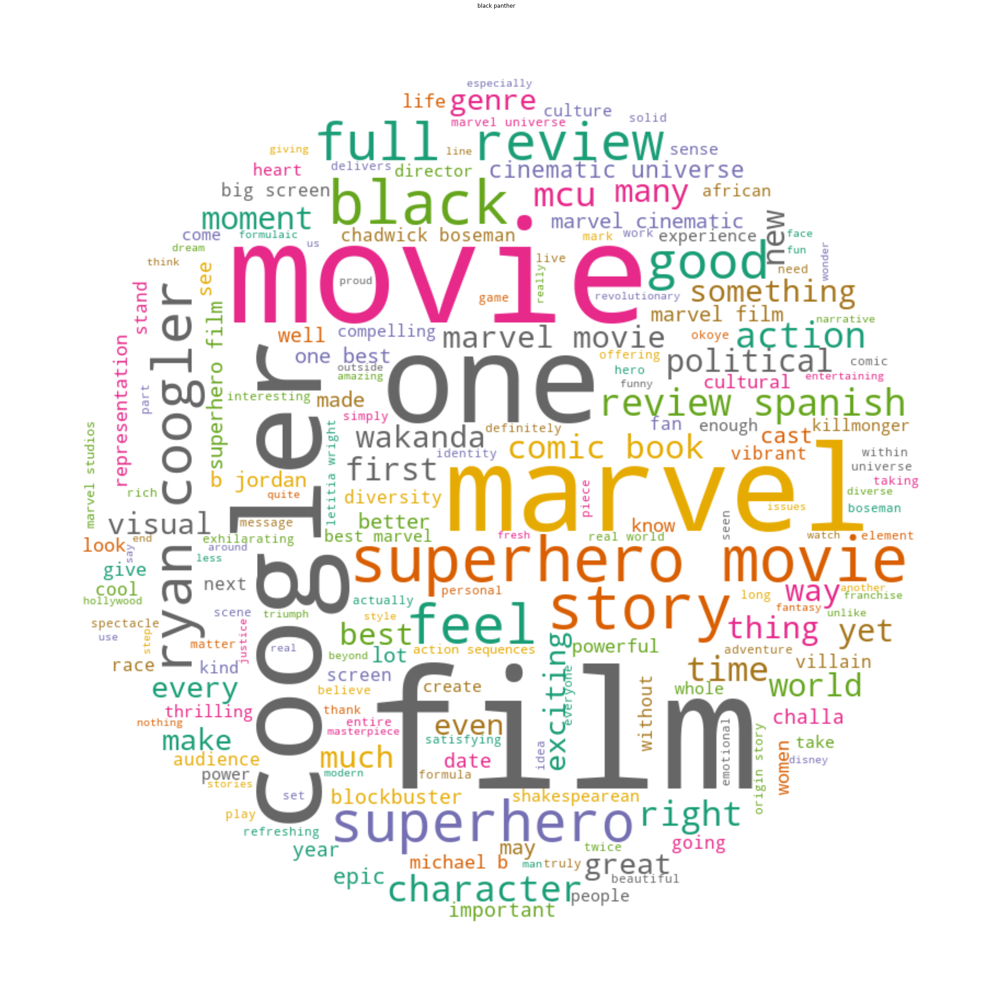

In [71]:
### you can change the content of movie_list to generate wordcloud for different movies
movie_list = score.movie[:3]
wordcloud("freq",df,"movie","cleaned_review",movie_list)

In [73]:
movie_list

28972     avengers: endgame
252051               avatar
2750          black panther
Name: movie, dtype: object

#### 2.2. word frequency per score interval

In [81]:
from bisect import bisect_left
def score_interval(score, 
                   breakpoints=[20,40,60,80], 
                   target=["0-20","20-40","40-60","60-80","80-100"]):
    i = bisect_left(breakpoints, score)
    return target[i]

In [82]:
df["score_interval"] = df.score.apply(score_interval)
df.head()

,unnamed: 0,movie,reviewer,review,score,cleaned_review,vader_sentiment,release year,rerelease,domestic gross,...,audience_rating,audience_count,top_critics,discrepacy,diverse,abs_diverse,discrepancy,word_count,word_count_unique,score_interval
0,389,together,Lynn Venhaus,Perhaps reliving a public health emergency tha...,69.0,perhaps reliving public health emergency fresh...,0.3818,2021,N,214390,...,89.0,7756.0,False,-21.0,1.0,1.0,-20.0,25,22,60-80
1,389,together,Lynn Venhaus,Perhaps reliving a public health emergency tha...,69.0,perhaps reliving public health emergency fresh...,0.3818,2001,N,1034829,...,89.0,7756.0,False,-21.0,1.0,1.0,-20.0,25,22,60-80
2,390,together,Tracey Petherick,The portrait of a seemingly doomed relationshi...,80.0,portrait seemingly doomed relationship shadow ...,-0.6369,2021,N,214390,...,89.0,7756.0,False,-10.0,1.0,1.0,-9.0,22,21,60-80
3,390,together,Tracey Petherick,The portrait of a seemingly doomed relationshi...,80.0,portrait seemingly doomed relationship shadow ...,-0.6369,2001,N,1034829,...,89.0,7756.0,False,-10.0,1.0,1.0,-9.0,22,21,60-80
4,391,together,Jesse Hassenger,When Together confronts the helpless living ni...,69.0,confronts helpless living nightmare pandemic o...,-0.7964,2021,N,214390,...,89.0,7756.0,False,-21.0,1.0,1.0,-20.0,18,17,60-80


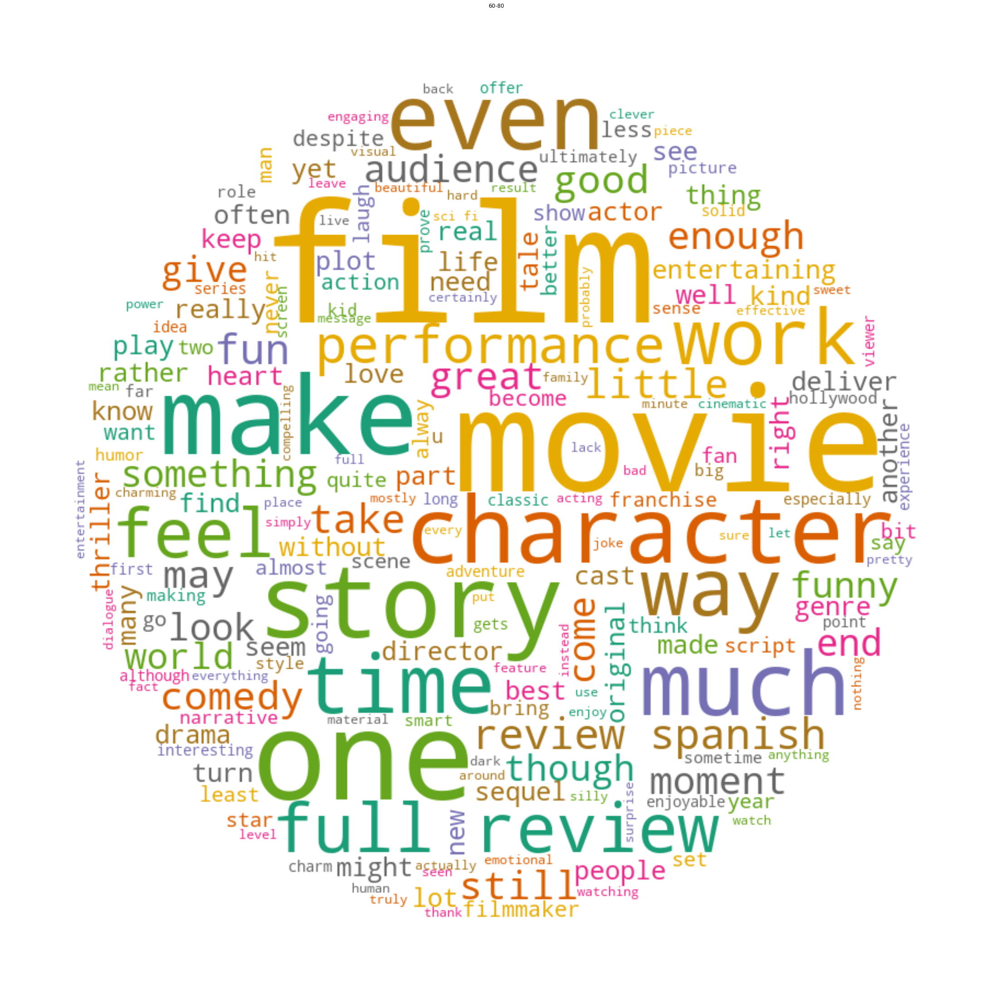

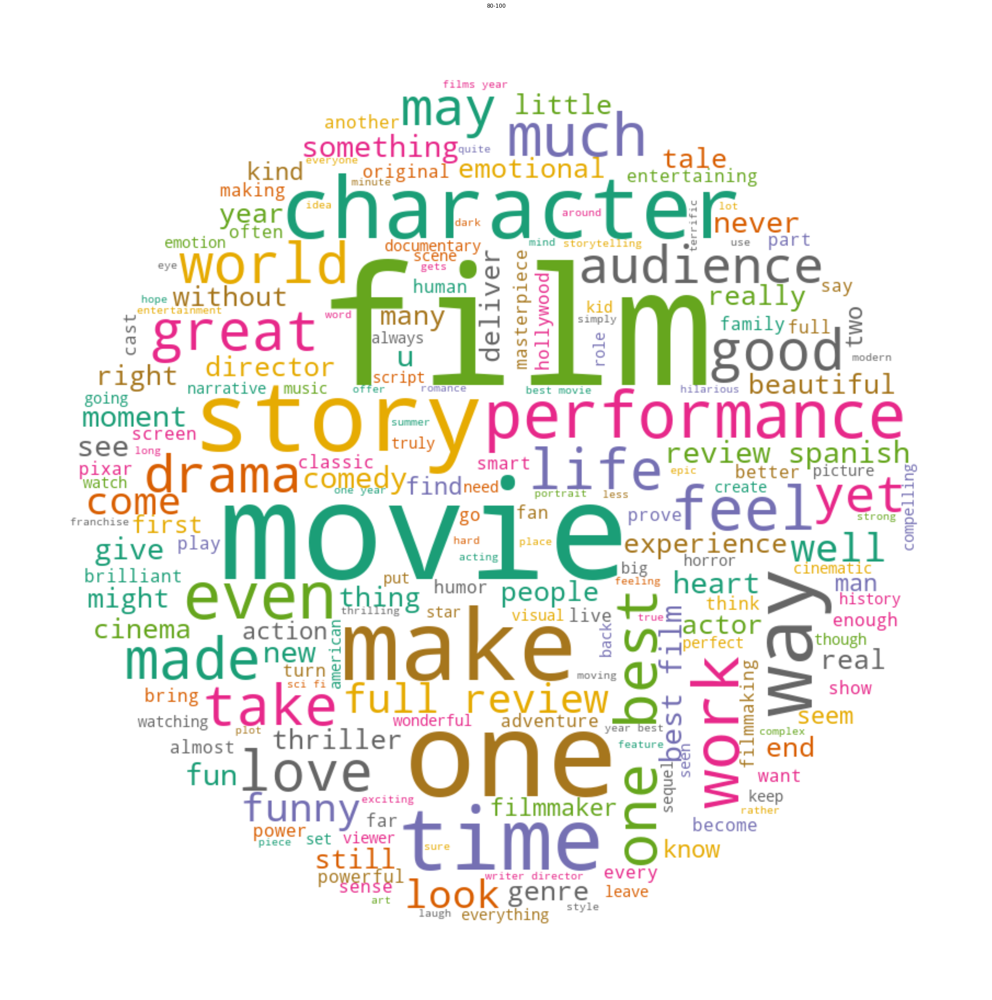

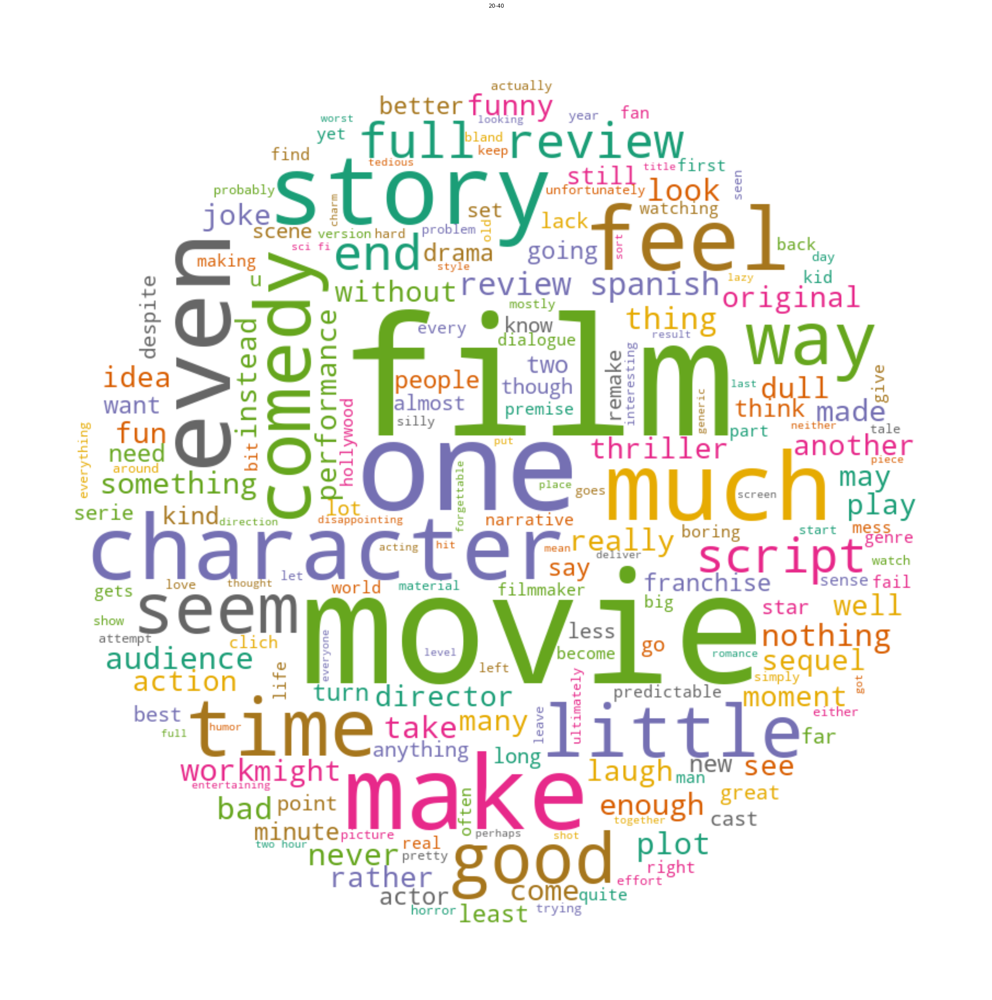

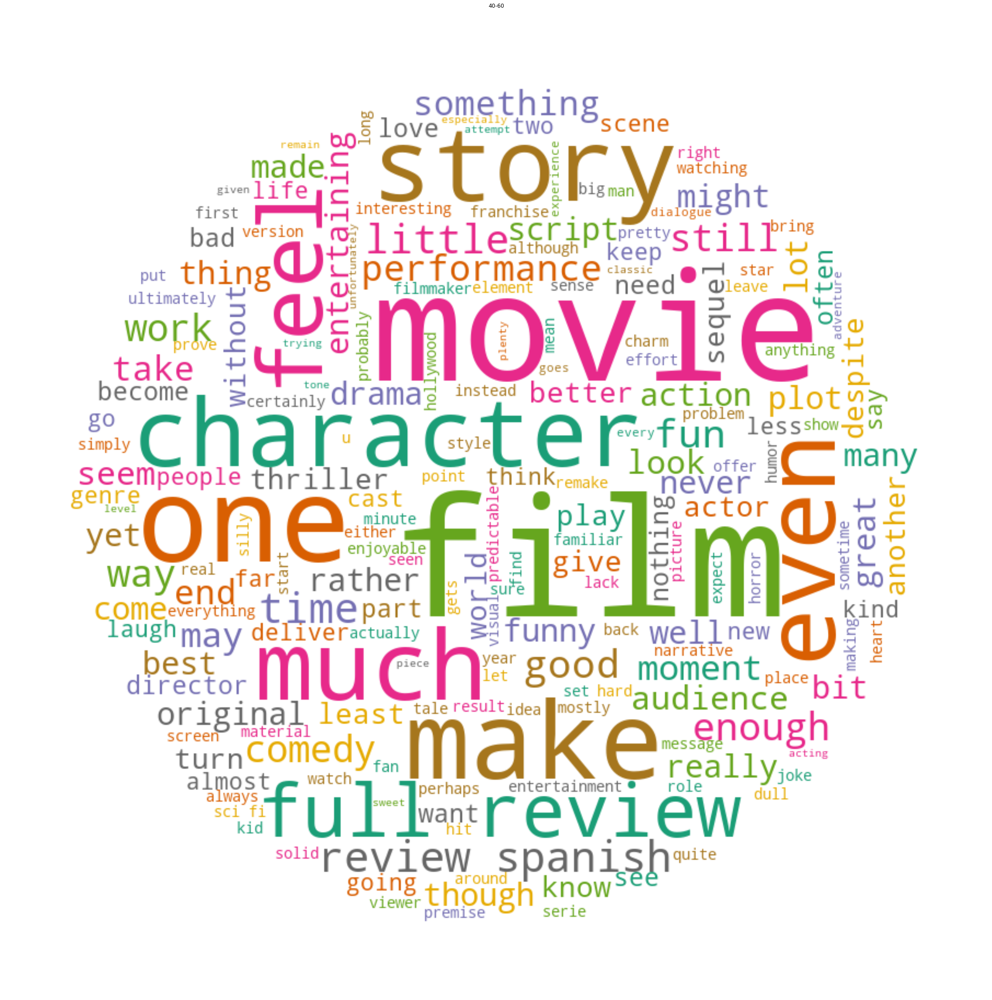

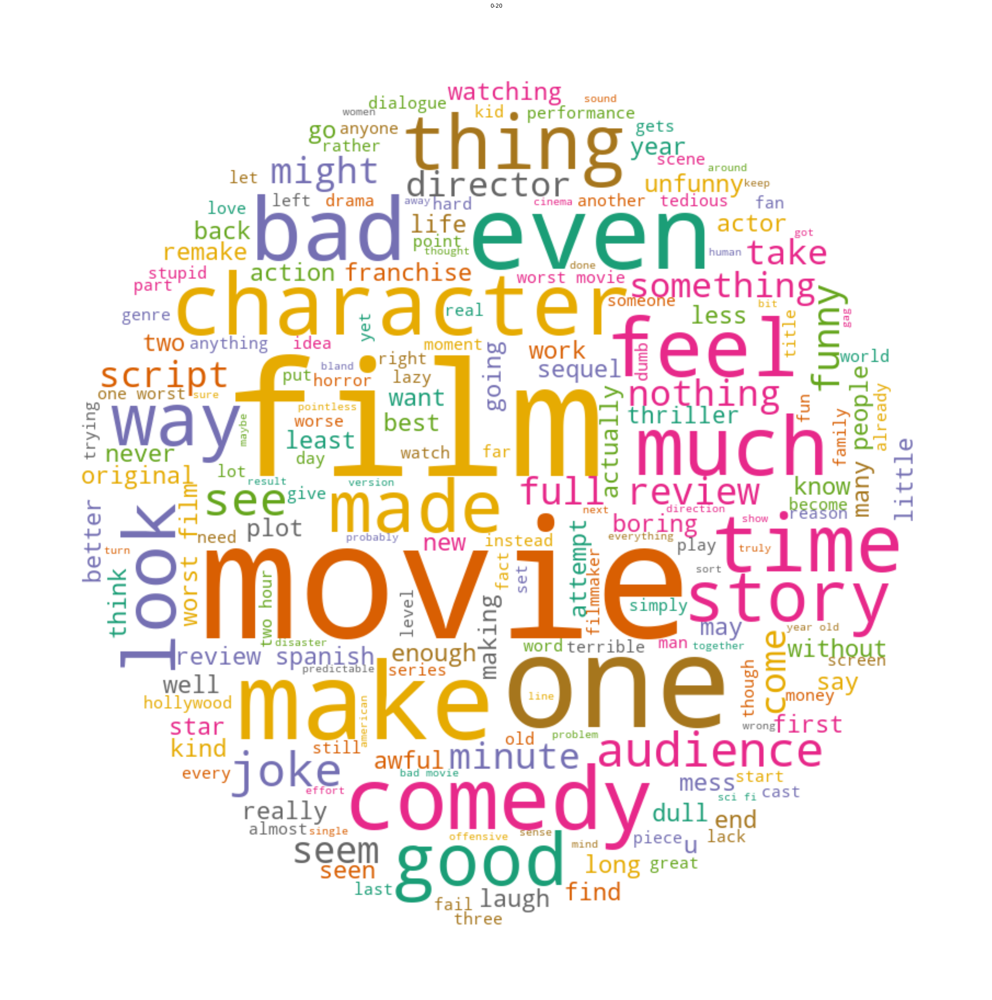

In [83]:
score_int = df.score_interval.unique()
wordcloud("freq", df, "score_interval", "cleaned_review", score_int)

#### 2.3. others

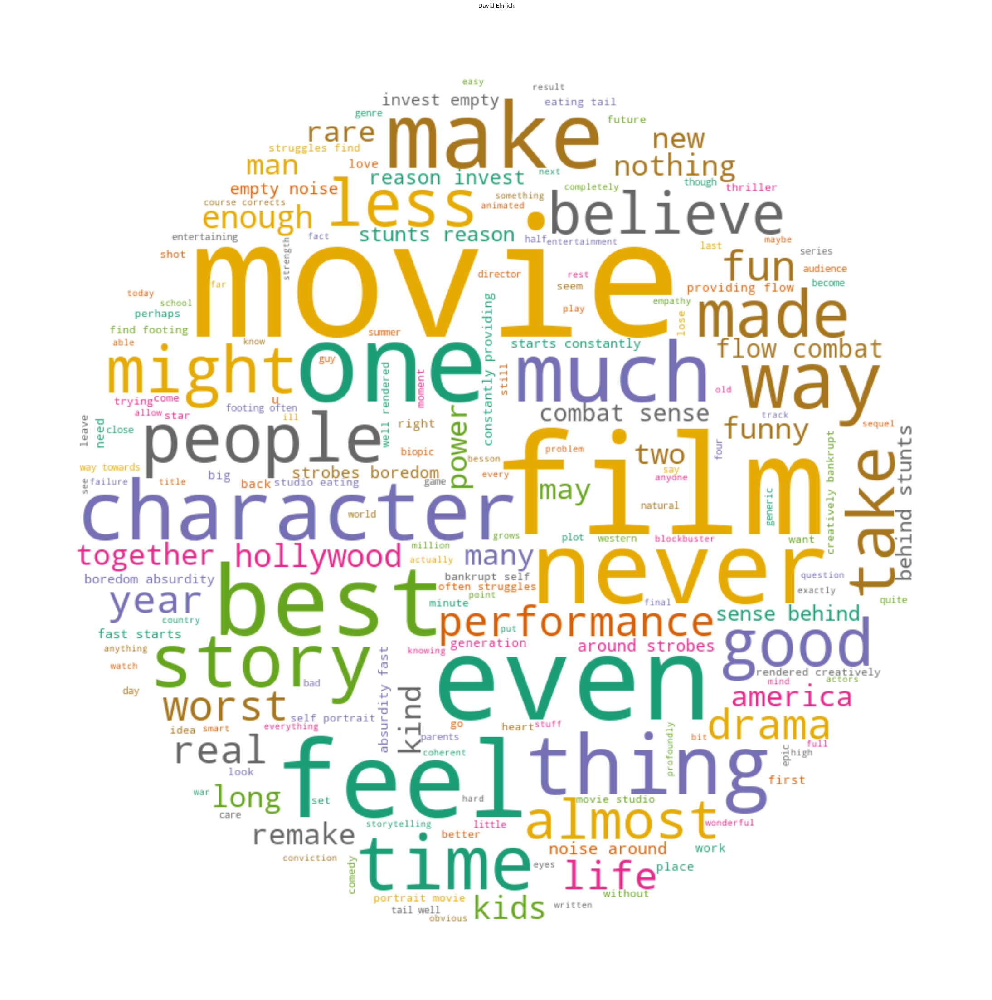

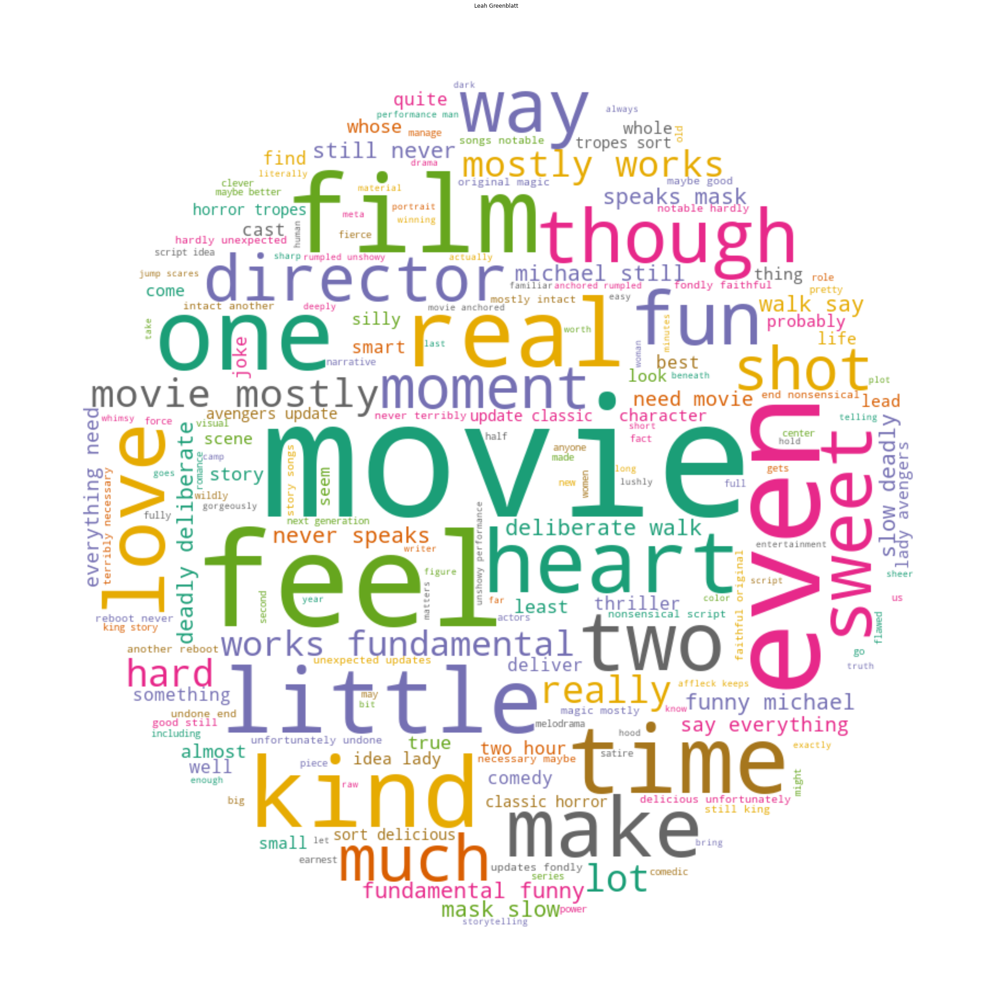

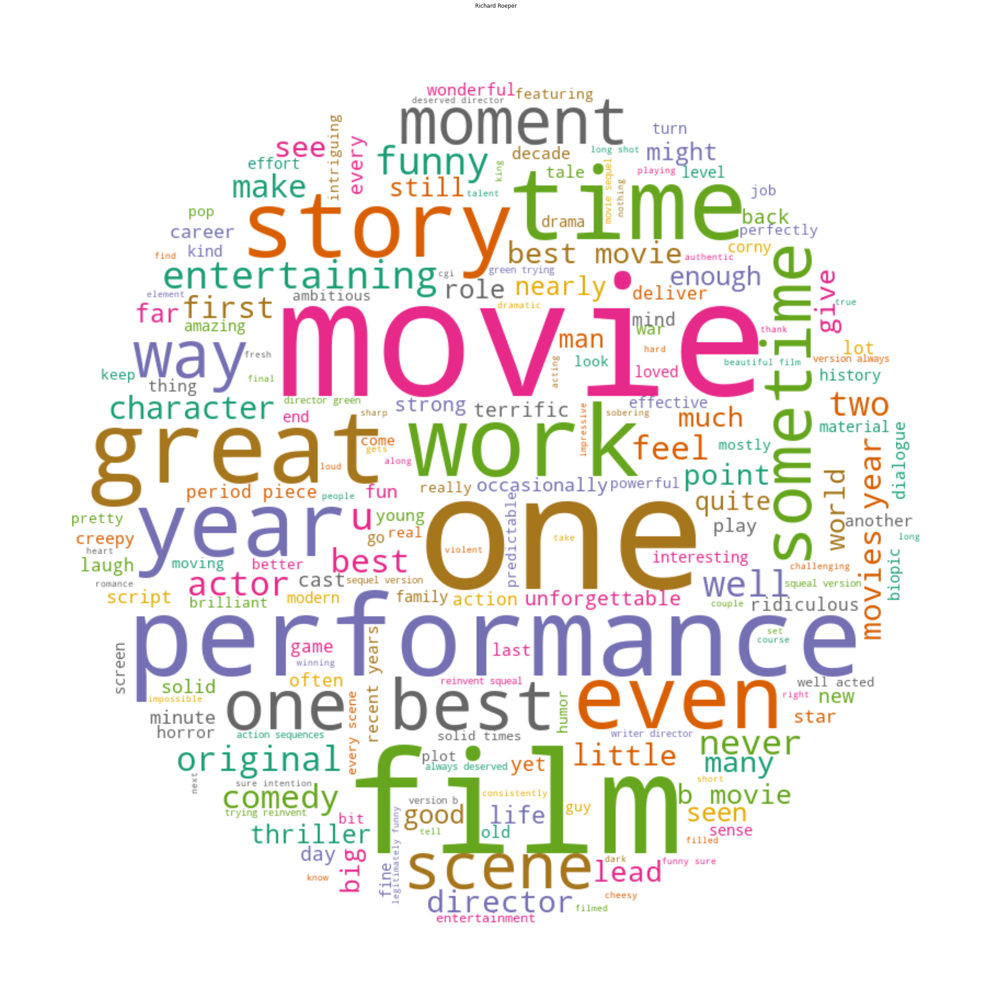

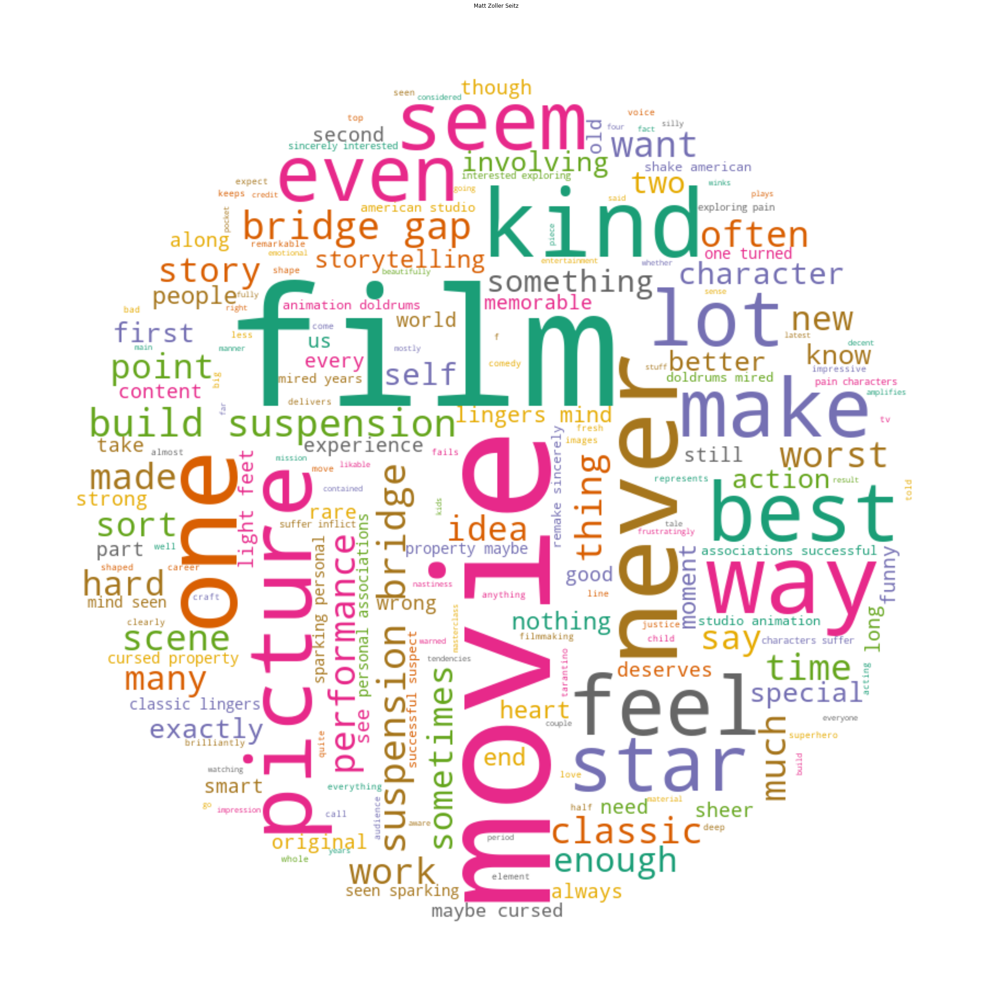

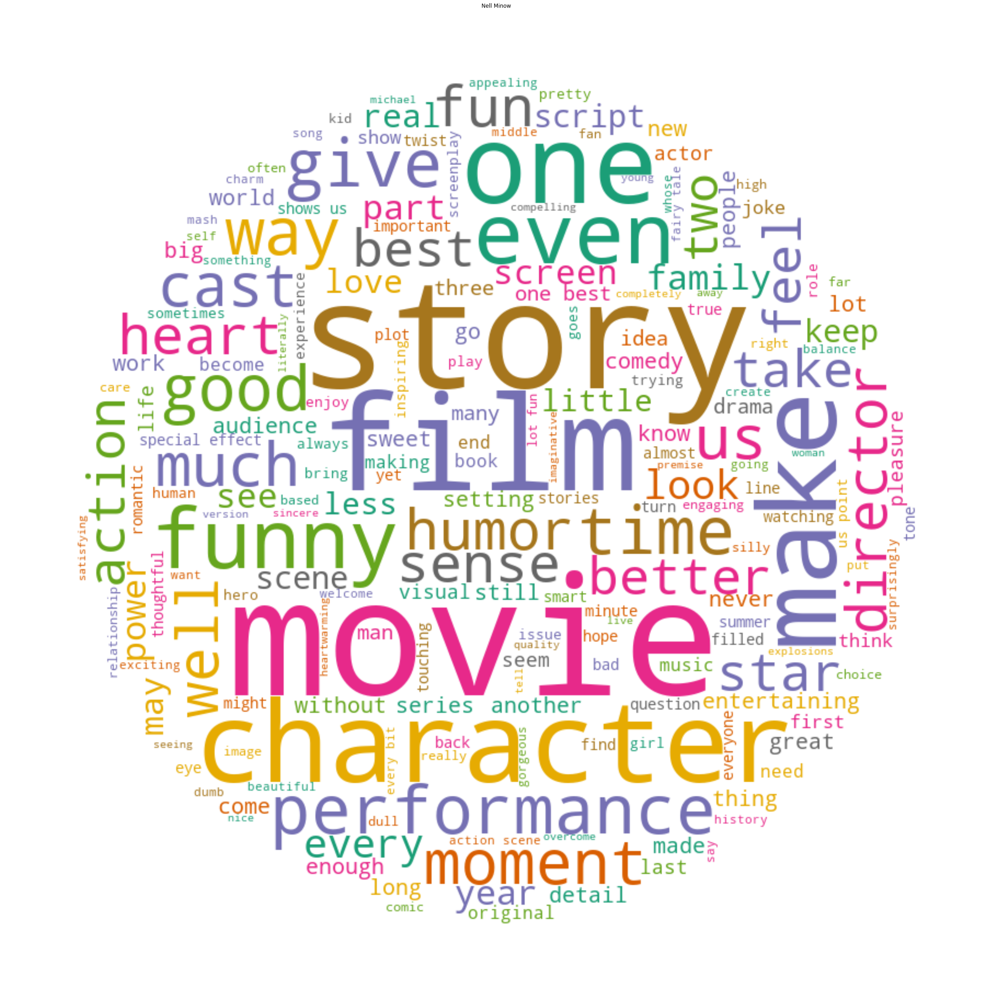

In [84]:
## by top reviewer to view their word preference
lists = df[df.top_critics]["reviewer"].unique()[:5]
wordcloud("freq", df, "reviewer", "cleaned_review", lists)

### 3. Tf-idf

#### 3.1. calculation

In [85]:
from sklearn.feature_extraction.text import TfidfVectorizer

cv = TfidfVectorizer()
tfidf = cv.fit_transform(final_rt_df.cleaned_review)
# sum_tf = pd.DataFrame(tfidf.sum(axis=0))
tfidf.columns = cv.get_feature_names()
tfidf

<279350x64778 sparse matrix of type '<class 'numpy.float64'>'
	with 3387016 stored elements in Compressed Sparse Row format>

#### 3.2. Wordcloud based on Tf-Idf

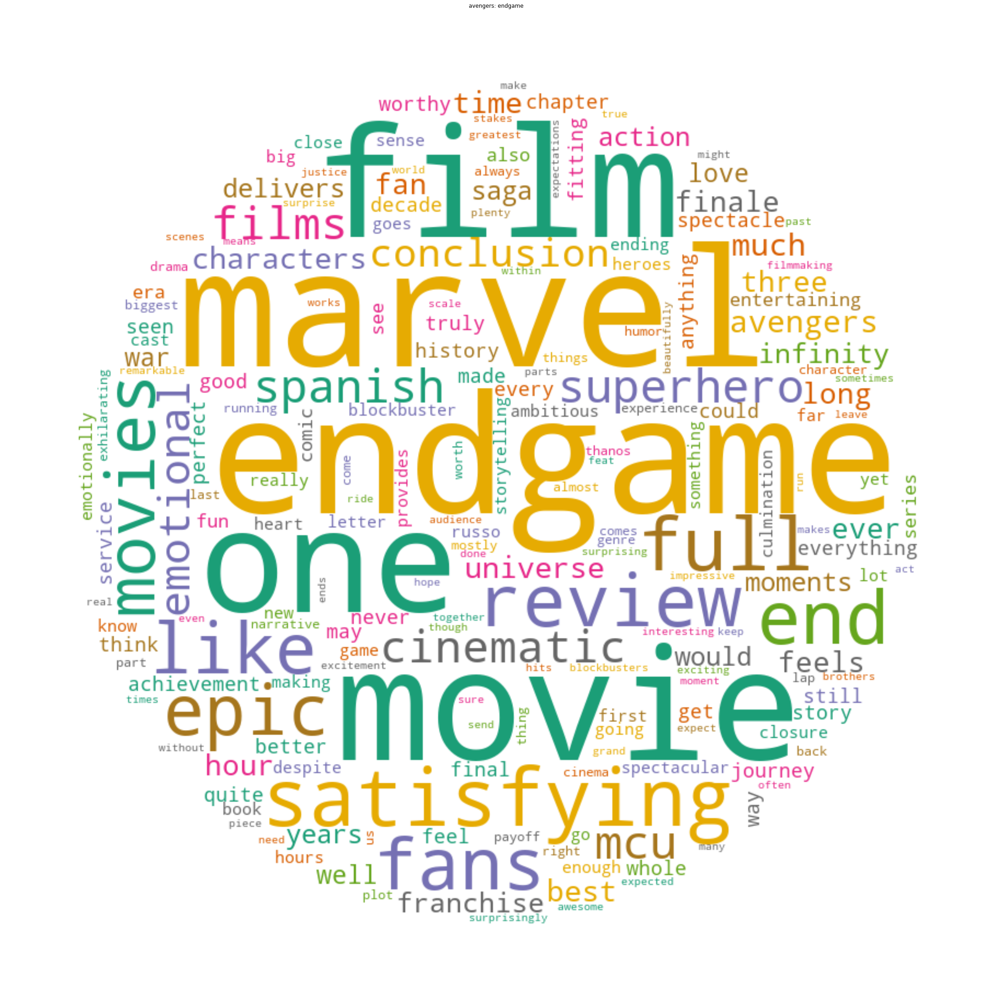

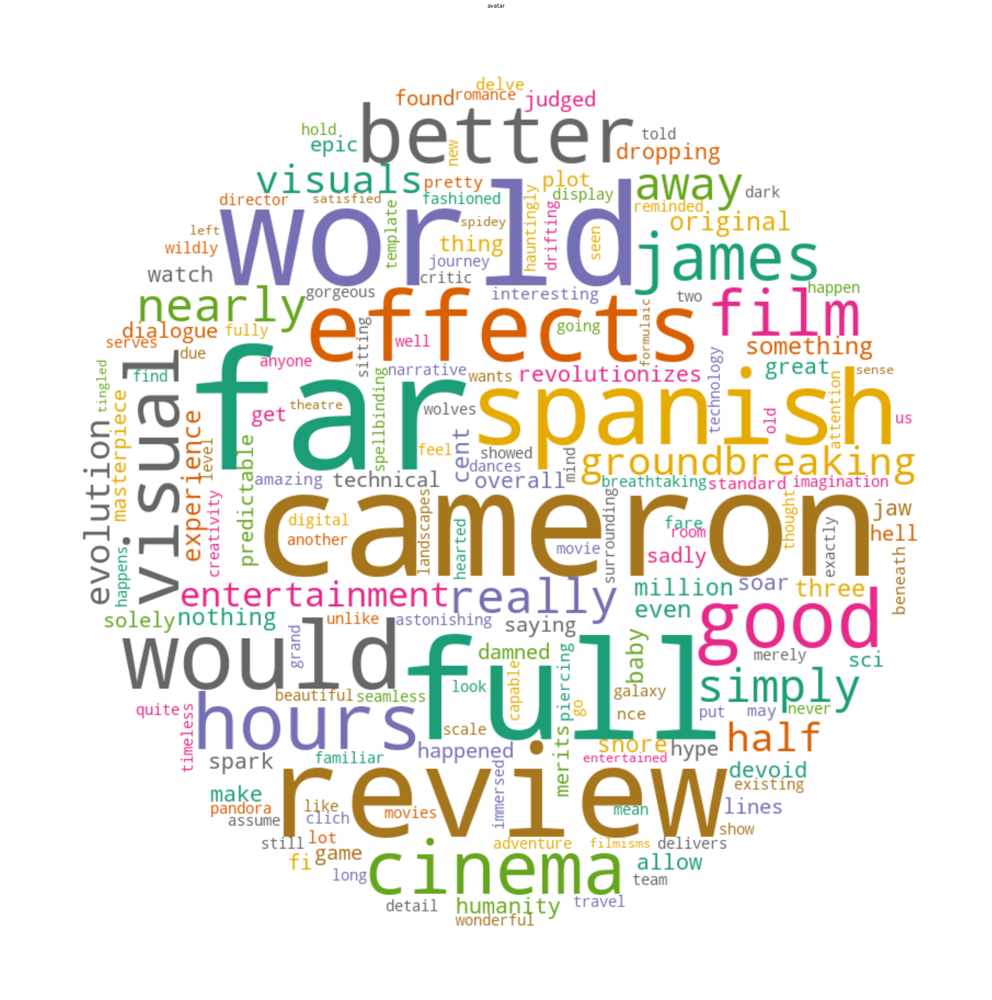

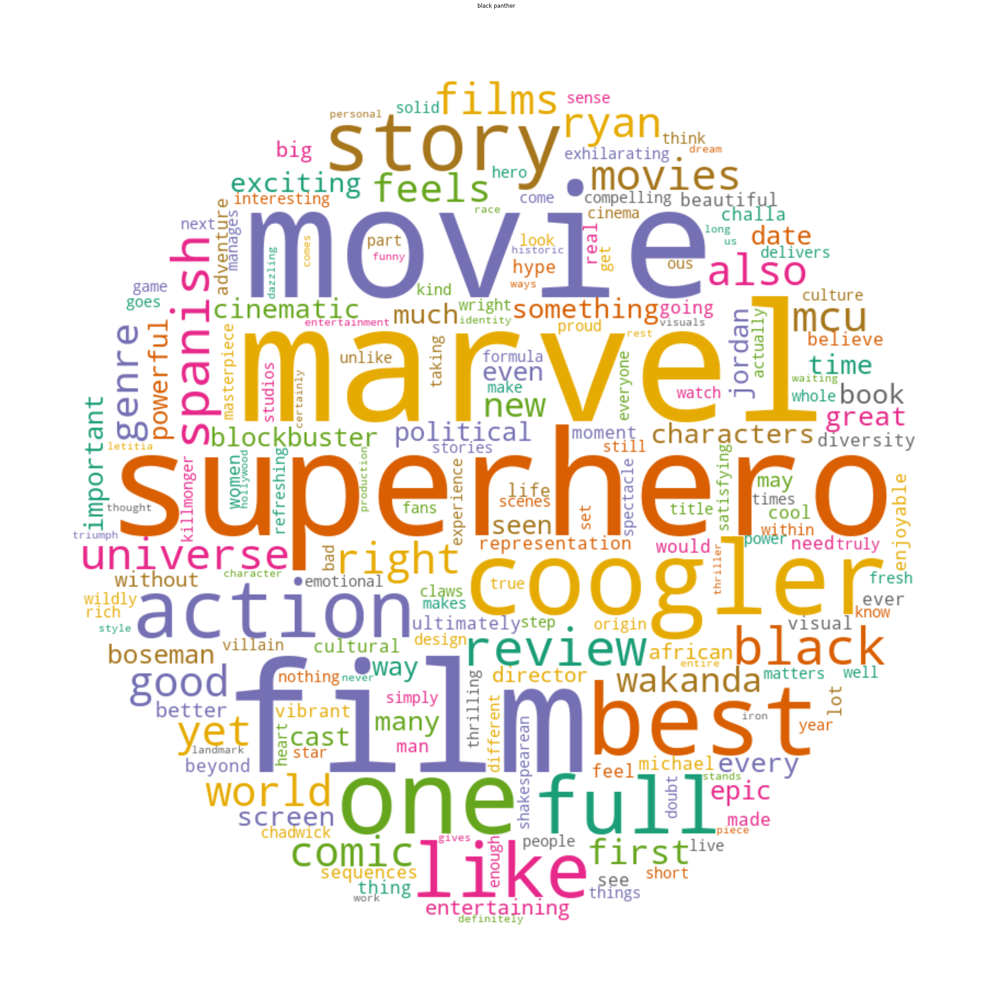

In [72]:
## code details could be found in the wordcloud() function
### per movie
movie_list = score.movie[:3]
print(movie_list)
wordcloud("tf-idf",df,"movie","cleaned_review",movie_list)

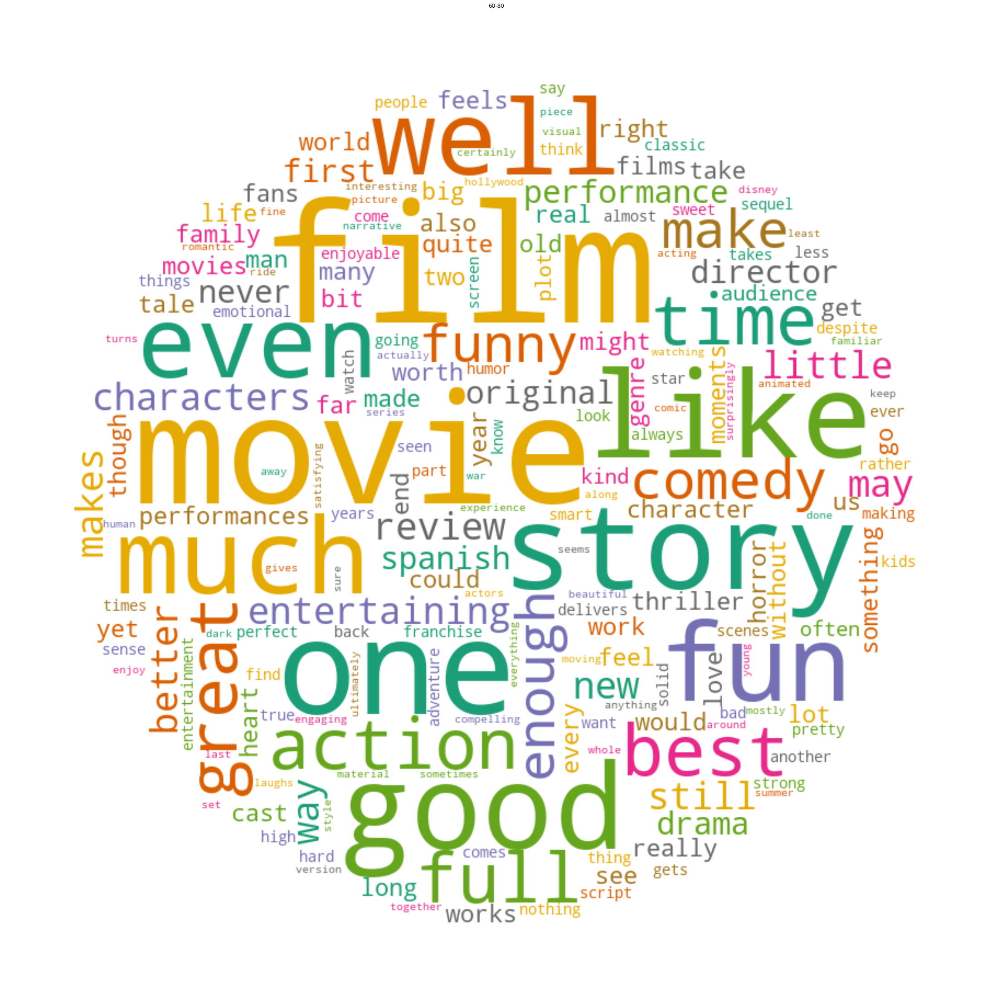

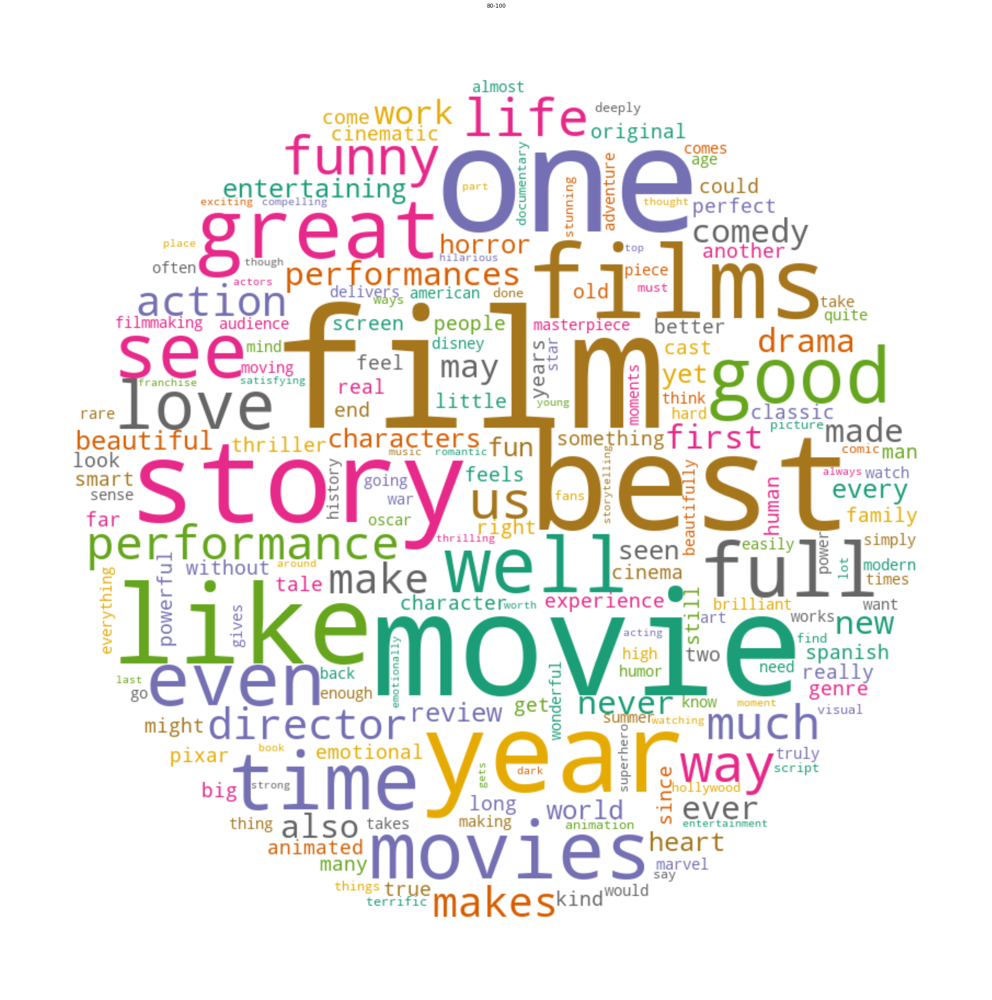

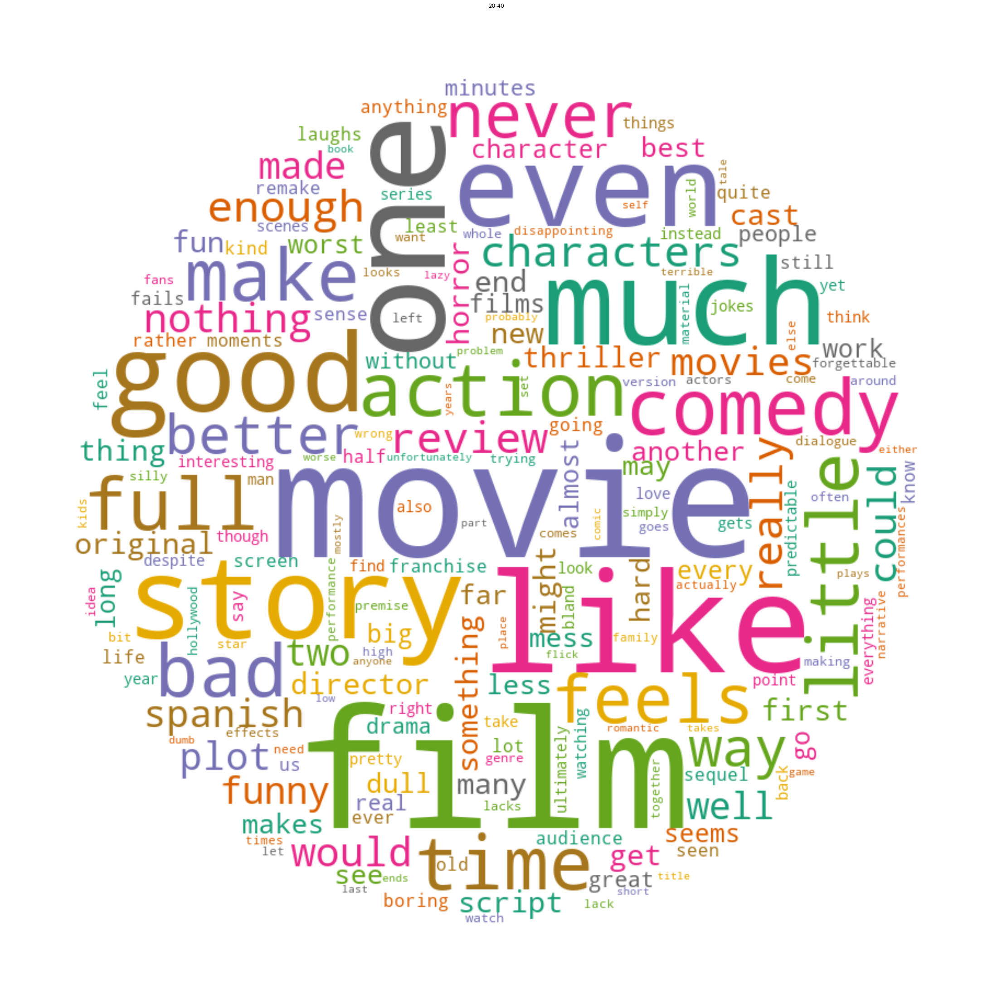

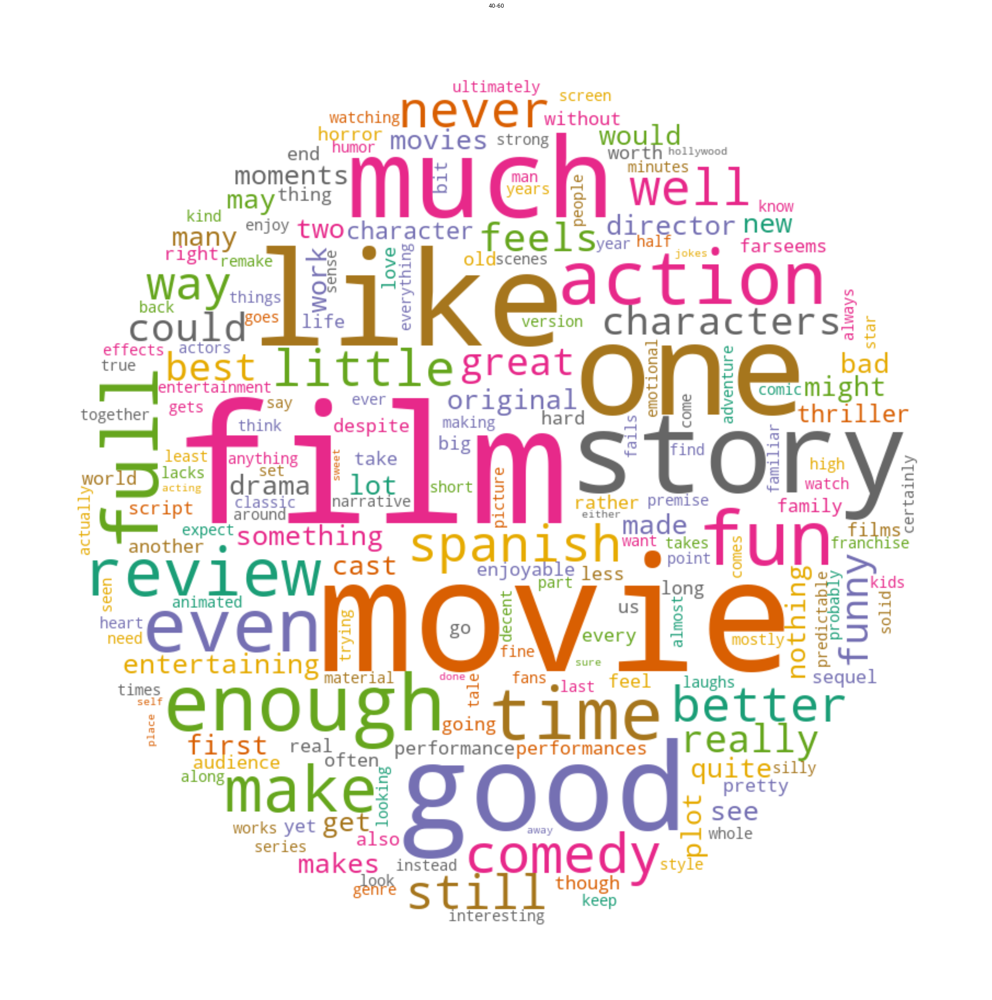

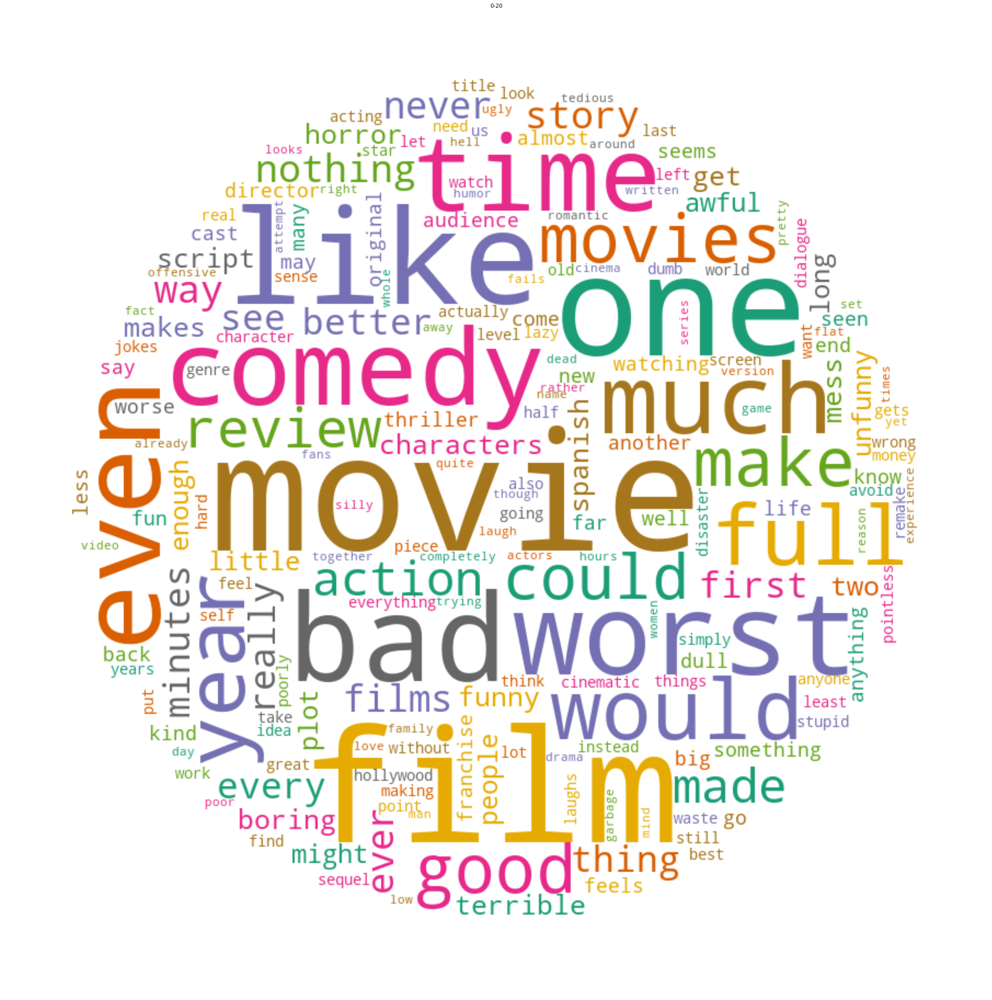

In [87]:
## per score interval
score_int = df.score_interval.unique()
wordcloud("tf-idf", df, "score_interval", "cleaned_review", score_int)

### 4. PCA

since the PCA for our large dataset is too complex and cost high memories, only 1000 PCs available on my computer. 36% variance explained. Data saved in "pcd_df.pk".

Suggest to pass this step.

In [25]:
# ## PCA code from lecture -- modified to sparse dataset
# ## function details see utils.py
# import time
# startTime = time.time()

# pca_red = sparse_pca_fun(tfidf, 1000, "./pickles/", "pca")
# split_pickles(pca_red, "./pickles/", "pca_df_", 8)

# executionTime = (time.time() - startTime)
# print('Execution time in seconds: ' + str(executionTime))
# print(executionTime)

Explained variance: 0.36744174444847244
Execution time in seconds: 268.80108165740967
268.80108165740967


In [ ]:
# out_path = "./pickles/"
# NUM_OF_PROCESSES = 8
# pca_red = merge_pickle_dfs('pca_df_', NUM_OF_PROCESSES, out_path)

### 5. Sentiment Analysis

In [31]:
df["sentiment"] = ["Positive" if x>0 else "Negative" for x in df['vader_sentiment']]

D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


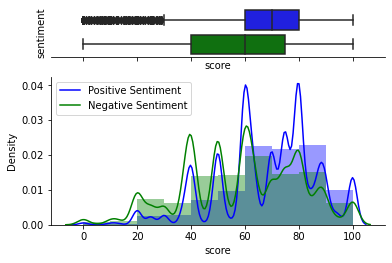

In [32]:
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, 
                                    gridspec_kw={"height_ratios": (.25, .75)})

sns.boxplot(x=df.score, y=df.sentiment, palette= ['b','g'], ax=ax_box)
sns.distplot(df[df.vader_sentiment > 0]['score'], bins=10, color='b', ax=ax_hist)
sns.distplot(df[df.vader_sentiment<= 0]['score'], bins=10, color='g', ax=ax_hist)

ax_box.set(yticks=[])
sns.despine(ax=ax_hist)
sns.despine(ax=ax_box, left=True)
# plt.title('Review Score Distribution based on Sentiments', fontsize=18)
# plt.xlabel('Score', fontsize=16)
# plt.ylabel('Frequency', fontsize=16)
plt.legend(['Positive Sentiment','Negative Sentiment'])

<AxesSubplot:xlabel='vader_sentiment', ylabel='score'>

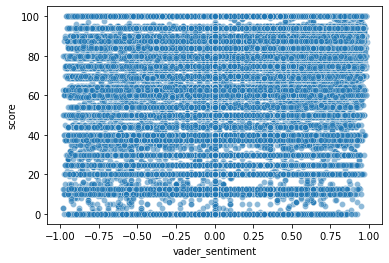

In [34]:
# sns.scatterplot(x=df.vader_sentiment, y=df.score, alpha = 0.5)
# ## not meaningful

In [38]:
df.head()

,unnamed: 0,movie,reviewer,review,score,cleaned_review,vader_sentiment,release year,rerelease,domestic gross,...,tomatometer_status,tomatometer_rating,tomatometer_count,audience_rating,audience_count,discrepancy,diverse,abs_diverse,top_critics,sentiment
0,389,together,Lynn Venhaus,Perhaps reliving a public health emergency tha...,69.0,perhaps reliving public health emergency fresh...,0.3818,2021,N,214390,...,Certified-Fresh,90.0,81.0,89.0,7756.0,-20.0,1.0,1.0,False,Positive
1,389,together,Lynn Venhaus,Perhaps reliving a public health emergency tha...,69.0,perhaps reliving public health emergency fresh...,0.3818,2001,N,1034829,...,Certified-Fresh,90.0,81.0,89.0,7756.0,-20.0,1.0,1.0,False,Positive
2,390,together,Tracey Petherick,The portrait of a seemingly doomed relationshi...,80.0,portrait seemingly doomed relationship shadow ...,-0.6369,2021,N,214390,...,Certified-Fresh,90.0,81.0,89.0,7756.0,-9.0,1.0,1.0,False,Negative
3,390,together,Tracey Petherick,The portrait of a seemingly doomed relationshi...,80.0,portrait seemingly doomed relationship shadow ...,-0.6369,2001,N,1034829,...,Certified-Fresh,90.0,81.0,89.0,7756.0,-9.0,1.0,1.0,False,Negative
4,391,together,Jesse Hassenger,When Together confronts the helpless living ni...,69.0,confronts helpless living nightmare pandemic o...,-0.7964,2021,N,214390,...,Certified-Fresh,90.0,81.0,89.0,7756.0,-20.0,1.0,1.0,False,Negative


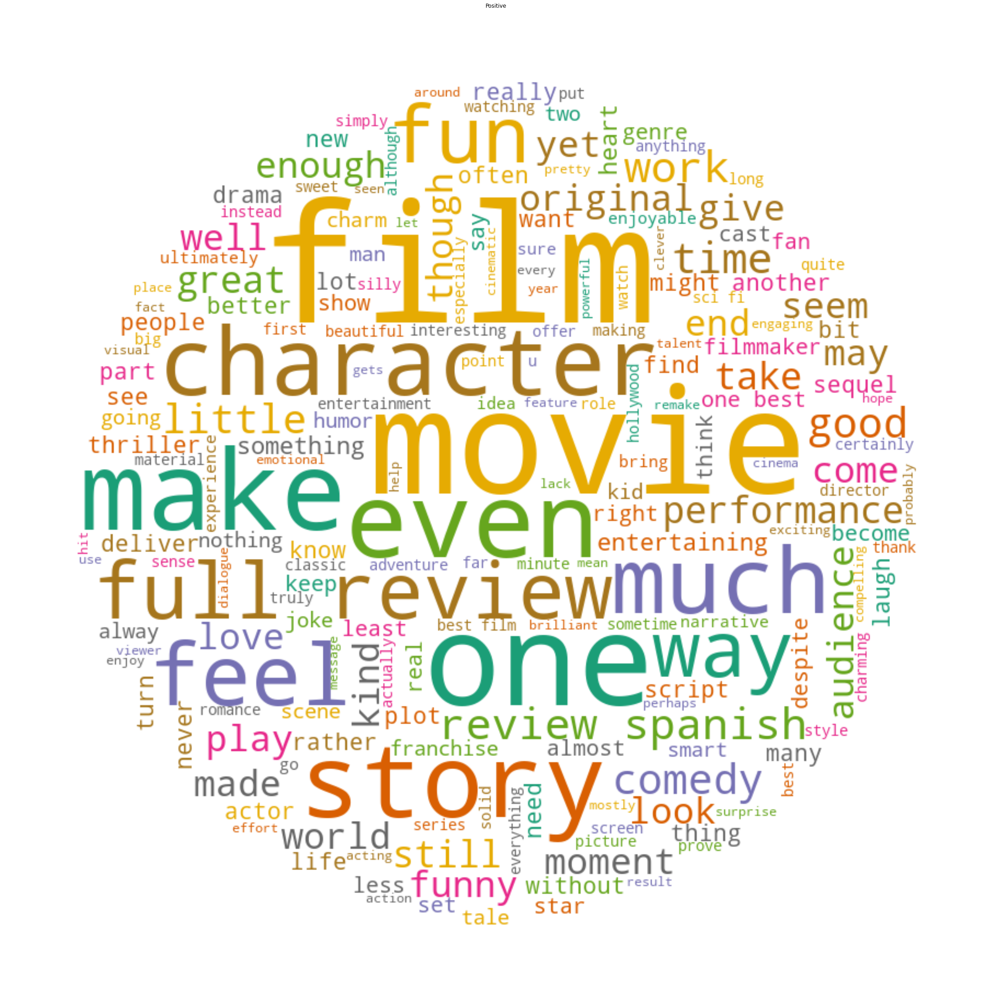

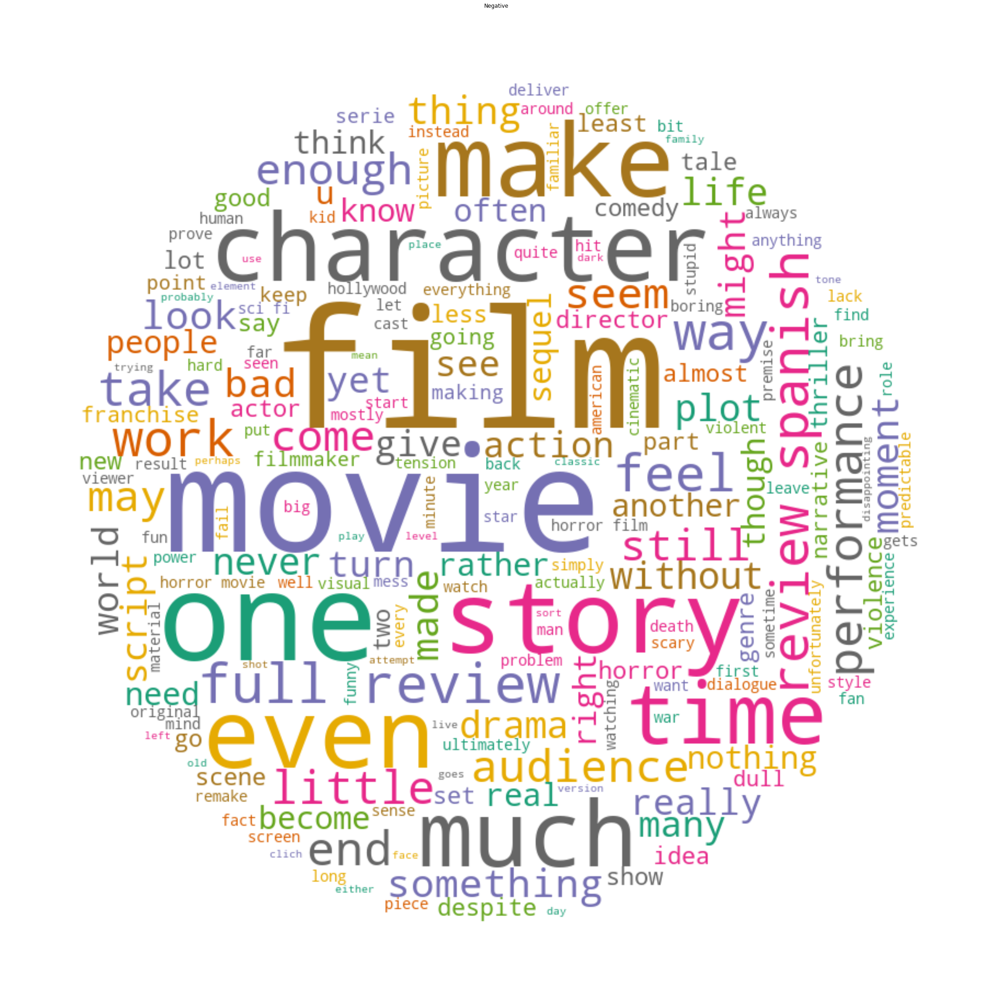

In [39]:
### Word cloud
senti = ["Positive", "Negative"]
wordcloud("freq",df,"sentiment","cleaned_review",senti)